<a href="https://colab.research.google.com/github/luadeprataart/Reconhecimento-de-Padroes/blob/main/C%C3%B3pia_de_Desenvolvimento_de_Sistemas_de_IA_para_An%C3%A1lise_e_Previs%C3%A3o_de_Dados_no_Kaggle.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Desenvolvimento de Sistemas de IA para Análise e Previsão de Dados no Kaggle**


# Parte 2: Tarefa de Classificação -> 5 pontos

Nesta parte do projeto, vocês selecionarão uma base de dados adequada para uma tarefa de classificação. Isso pode incluir a classificação de produtos, avaliação de sentimentos em revisões, ou qualquer conjunto de dados de classificação de interesse. Vocês seguirão os seguintes passos:

1.Seleção de Dados: Escolha uma base de dados apropriada no Kaggle para a tarefa de classificação. A base precisa passar por uma aprovação do professor.

2.Pré-processamento: Realize o pré-processamento de dados, tratamento de desequilíbrio de classes e outras etapas relevantes.

3.Análise Exploratória de Dados (EDA): Realize uma análise exploratória dos dados para extrair insights e entender a distribuição das classes.

4.Modelos de Classificação: Implemente 3 modelos de classificação, utilizando Naive Bayes, KNN, e Redes Neurais, para classificar os dados.

5.Avaliação e Apresentação: Avalie o desempenho dos modelos de classificação e prepare uma apresentação destacando o processo, as métricas de avaliação e as conclusões.


In [ ]:
import numpy as np
import pandas as pd

df_rev = pd.read_csv('/content/drive/MyDrive/datasets/train.csv', sep=',', index_col=None)

print(df_rev.shape)

(2000, 21)


**1.Seleção de Dados:** Escolha uma base de dados apropriada no Kaggle para a tarefa de regressão. A base precisa passar por uma aprovação do professor.


In [ ]:
display(df_rev.head(n=6))

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1
5,1859,0,0.5,1,3,0,22,0.7,164,1,...,1004,1654,1067,17,1,10,1,0,0,1


In [ ]:
display(df_rev.describe())

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,...,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,...,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,...,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,...,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,...,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,...,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,...,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,...,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


In [ ]:
df_rev.replace('', pd.NA, inplace=True) #Tratando espaços vazios para null
df_rev.isnull().sum() #Contagem de quantos dados faltantes existem nos dados
#Dataset excelente e sem dados faltantes

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
price_range      0
dtype: int64

**2.Pré-processamento:** Realize pré-processamento de dados, incluindo tratamento de valores ausentes, codificação de variáveis categóricas e normalização.


In [ ]:
#Analizando os tipos de dados de cada coluna e se necessitam de tratamento

import pandas as pd

for coluna in df_rev.columns:
    print(f'Nome da coluna: {coluna} \n')
    print(f'Tipos de dados únicos na coluna:')
    tipos_de_dados_unicos = df_rev[coluna].unique()
    print(tipos_de_dados_unicos)
    print('-' * 60)



Nome da coluna: battery_power 

Tipos de dados únicos na coluna:
[ 842 1021  563 ... 1139 1467  858]
------------------------------------------------------------
Nome da coluna: blue 

Tipos de dados únicos na coluna:
[0 1]
------------------------------------------------------------
Nome da coluna: clock_speed 

Tipos de dados únicos na coluna:
[2.2 0.5 2.5 1.2 1.7 0.6 2.9 2.8 2.1 1.  0.9 1.1 2.6 1.4 1.6 2.7 1.3 2.3
 2.  1.8 3.  1.5 1.9 2.4 0.8 0.7]
------------------------------------------------------------
Nome da coluna: dual_sim 

Tipos de dados únicos na coluna:
[0 1]
------------------------------------------------------------
Nome da coluna: fc 

Tipos de dados únicos na coluna:
[ 1  0  2 13  3  4  5  7 11 12 16  6 15  8  9 10 18 17 14 19]
------------------------------------------------------------
Nome da coluna: four_g 

Tipos de dados únicos na coluna:
[0 1]
------------------------------------------------------------
Nome da coluna: int_memory 

Tipos de dados únicos na c

In [ ]:
#Verificando se restou algum dado diferente dentro do dataset

def todos_os_mesmos_tipos(coluna):
    if not coluna:    #Verifica se a coluna está vazia
        return True

    tipo_referencia = type(coluna[0])    #Obtém o tipo do primeiro elemento da coluna

    #Percorre a coluna e compara o tipo de cada elemento com o tipo de referência
    for elemento in coluna:
        if type(elemento) != tipo_referencia:
            return False

    return True #Se todos os tipos forem iguais, retorna True

for coluna in df_rev.columns:
  print(coluna)
  if todos_os_mesmos_tipos(coluna):
      print("Todos os elementos da coluna têm o mesmo tipo.")
  else:
      print("Os elementos da coluna têm tipos diferentes.")
  print('-' * 60)

battery_power
Todos os elementos da coluna têm o mesmo tipo.
------------------------------------------------------------
blue
Todos os elementos da coluna têm o mesmo tipo.
------------------------------------------------------------
clock_speed
Todos os elementos da coluna têm o mesmo tipo.
------------------------------------------------------------
dual_sim
Todos os elementos da coluna têm o mesmo tipo.
------------------------------------------------------------
fc
Todos os elementos da coluna têm o mesmo tipo.
------------------------------------------------------------
four_g
Todos os elementos da coluna têm o mesmo tipo.
------------------------------------------------------------
int_memory
Todos os elementos da coluna têm o mesmo tipo.
------------------------------------------------------------
m_dep
Todos os elementos da coluna têm o mesmo tipo.
------------------------------------------------------------
mobile_wt
Todos os elementos da coluna têm o mesmo tipo.
------------


**3.Análise Exploratória de Dados (EDA):** Realize uma análise exploratória dos dados para entender a relação entre as variáveis e identificar padrões.


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
# matriz de gráficos scatter (8 minutos de execucao)
sns.pairplot(df_rev, hue='price_range', height=3.5); # size -> height

# mostra o gráfico usando a função show() da matplotlib
plt.show()

KeyboardInterrupt: ignored

Error in callback <function _draw_all_if_interactive at 0x7924d7d65d80> (for post_execute):


KeyboardInterrupt: ignored

Error in callback <function flush_figures at 0x7924d7d65000> (for post_execute):


KeyboardInterrupt: ignored

In [ ]:
# Matriz de Correlação (Heatmap)
correlation_matrix = df_rev.corr()

display(correlation_matrix)

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlação')
plt.show()

#Price range e Ram é o onico que tem alta correlação em 0.9, entretanto price range é a coluna de predição e, portanto, não haverá alterações


**4.Modelos de Regressão:** Implemente 3 modelos de classificação, utilizando Naive Bayes, KNN, e Redes Neurais, para classificar os dados.


In [ ]:
df_rev.describe()

# Naive Bayes (Gaussian Naive Bayes)


In [ ]:
#Embora exista 3 dados binarios no dataset o gaussian naive bayes é o que melhor trabalha com o conjunto total de dados

from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Vamos dividir os dados em recursos (X) e o alvo (y).
X = df_rev.drop(columns=['price_range'])
y = df_rev['price_range']

# Dividir os dados em conjunto de treinamento e conjunto de teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Criar um classificador Gaussian Naive Bayes
model = GaussianNB()

# Treinar o classificador nos dados de treinamento
model.fit(X_train, y_train)

# Realizar previsões nos dados de teste
y_pred = model.predict(X_test)

# Avaliar o desempenho do modelo
accuracy = accuracy_score(y_test, y_pred)
print(f'Acurácia: {accuracy:.2f}')


# KNN (Eliminacao Sequencial)
Busco melhor eficiencia dos recursos que são poucos e menor custo computacional





In [ ]:
#KNN
# Dividindo os dados em recursos (X) e classe alvo (y)
X = df_rev.drop(columns=['price_range'])
y = df_rev['price_range']

#Dividindo em conjuntos de treinamento e teste
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.33, random_state=42)

In [ ]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
from sklearn.neighbors import KNeighborsClassifier

# cria um vetor que vai auxiliar a identificar quais registros são considerados
# no treino e quais não são, como se fosse um filtro
indices = []
for _ in range(len(X_train)):
  indices.append(True)

# faz a logica de tentar eliminar cada registro e ver se está correto
for i in range(len(X_train)):
  indices[i] = False
  model = KNeighborsClassifier(n_neighbors = 1) #melhor desempenho com k =1 vizinhos para acuracia
  model.fit(X_train[indices], y_train[indices])

  pred = model.predict([X_train.values[i]])
  if pred != y_train.values[i]:
    indices[i] = True

print("Quantas amostras de treino sobraram:", len(X_train[indices]))

# calcula o resultado final depois da redução

model = KNeighborsClassifier(n_neighbors = 1)
model.fit(X_train[indices], y_train[indices])
pred = model.predict(X_test)

print("Acurácia:", (pred == y_test).sum() / len(X_test) * 100)

# KNN (Inserção Sequencial)
Busco melhor eficiencia dos recursos que são poucos e menor custo computacional



In [ ]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
from sklearn.neighbors import KNeighborsClassifier

# cria um vetor que vai auxiliar a identificar quais registros são considerados
# no treino e quais não são, como se fosse um filtro
indices = []
for _ in range(len(X_train)):
  indices.append(False)

# inclui a primeira amostra ja que o modelo nunca vai acertar
indices[0] = True

# faz a logica de tentar inserir cada registro e ver se está correto
for i in range(1,len(X_train)):
  model = KNeighborsClassifier(n_neighbors = 1) #k = 1 pois o numero de vizinhos começa em 1
  model.fit(X_train[indices], y_train[indices])

  pred = model.predict([X_train.values[i]])
  if pred != y_train.values[i]:
    indices[i] = True

print("Quantas amostras de treino sobraram:", len(X_train[indices]))

# calcula o resultado final depois das insercoes

model = KNeighborsClassifier(n_neighbors = 1)
model.fit(X_train[indices], y_train[indices])
pred = model.predict(X_test)

print("Acurácia:", (pred == y_test).sum() / len(X_test) * 100)

In [ ]:
#O modelo de inserção foi superior ao de eliminação
#Por se tratar de um dataset pequeno, remover os dados resultou em uma perca de informações relevantes prejudiacando o desempenho do modelo.

In [ ]:
# Redes Neurais

# Redes Neurais

In [ ]:
# Funções utilitárias para verificar as métricas de erro do modelo
def plot_loss(history):
    plt.plot(history.history['loss'][1:], label='loss')
    plt.plot(history.history['val_loss'][1:], label='val_loss')
    plt.xlabel('Épocas')
    plt.ylabel('Erro')
    plt.legend()
    plt.grid(True)
    plt.show()


def plot_acc(history):
    plt.plot(history.history['accuracy'], label='acc')
    plt.plot(history.history['val_accuracy'], label='val_acc')
    plt.xlabel('Épocas')
    plt.ylabel('Acurácia')
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_mae(history):
    plt.plot(history.history['mean_absolute_error'], label='MAE')
    plt.plot(history.history['val_mean_absolute_error'], label='Val MAE')
    plt.xlabel('Épocas')
    plt.ylabel('Mean Absolute Error')
    plt.legend()
    plt.grid(True)

def plot_mse(history):
    plt.plot(history.history['mean_squared_error'], label='MSE')
    plt.plot(history.history['val_mean_squared_error'], label='val_MSE')
    plt.xlabel('Épocas')
    plt.ylabel('Erro Quadrático Médio (MSE)')
    plt.legend()
    plt.grid(True)

In [ ]:
# Importações
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers.experimental import preprocessing
from sklearn.model_selection import train_test_split
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from keras.callbacks import EarlyStopping

In [ ]:
np.random.seed(1)
tf.random.set_seed(1)
df_class_clean = df_rev.copy()

features = df_class_clean.columns.tolist()
features.remove('price_range')

X = df_class_clean[features]
y = df_class_clean['price_range']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=1)

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

In [ ]:
model = keras.Sequential([
    layers.Dense(20, activation='relu', input_shape=(20,)), # 20 atributos de entrada
    layers.Dense(250, activation='relu'),
    layers.Dense(260, activation='relu'),
    layers.Dense(4, activation='softmax')  # 4 classes de saída
])

model.summary()

# Valor default = 0.001
custom_optimizer = keras.optimizers.Adam(learning_rate=0.02)

# sparse_categorical_crossentropy utilizado para multiclasses com valores inteiros
model.compile(optimizer=custom_optimizer,
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Usado para parar o treinamento caso não haja melhora na métrica de validação
# early_stopping = EarlyStopping(monitor='val_loss', patience=15)

history = model.fit(
    X_train, y_train,
    epochs=190,
    validation_split = 0.2,
    batch_size=64,
    #callbacks=[early_stopping],
    verbose=2
    )

In [ ]:
plot_loss(history)
print("\n")
plot_acc(history)

In [ ]:
y_pred = model.predict(X_test)
print(y_pred)
#accuracy_score(np.round(y_pred), y_test)
y_pred_classes = np.argmax(y_pred, axis=1)

In [ ]:
print(y_pred_classes)

In [ ]:
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test, y_pred_classes)
print(accuracy)

In [ ]:
from sklearn.metrics import confusion_matrix
confusion = confusion_matrix(y_test, y_pred_classes)
print(confusion)

In [ ]:
from sklearn.metrics import f1_score, precision_score
precision = precision_score(y_test, y_pred_classes, average='weighted', zero_division=1)
print(precision)

In [ ]:
from sklearn.metrics import classification_report
report = classification_report(y_test, y_pred_classes)
print(report)

# Parte 1: Tarefa de Regressão -> 5 pontos

Nesta parte do projeto, vocês selecionarão uma base de dados adequada para uma tarefa de regressão. Alguns exemplos incluem previsão de preços de imóveis, previsão de vendas, ou qualquer conjunto de dados que envolva a previsão de um valor numérico. Vocês seguirão os seguintes passos:

1.Seleção de Dados: Escolha uma base de dados apropriada no Kaggle para a tarefa de regressão. A base precisa passar por uma aprovação do professor.

2.Pré-processamento: Realize pré-processamento de dados, incluindo tratamento de valores ausentes, codificação de variáveis categóricas e normalização.

3.Análise Exploratória de Dados (EDA): Realize uma análise exploratória dos dados para entender a relação entre as variáveis e identificar padrões.

4.Modelos de Regressão: Implemente 3 modelos de regressão, utilizando Regressão Linear, Árvore de Decisão e Redes Neurais, para prever o valor-alvo.

5.Avaliação e Apresentação: Avalie o desempenho dos modelos e prepare uma apresentação detalhando o processo, os resultados e as conclusões.

**1.Seleção de Dados:**
Escolha uma base de dados apropriada no Kaggle para a tarefa de regressão. A base precisa passar por uma aprovação do professor.



In [ ]:
import numpy as np
import pandas as pd

df_dataset = pd.read_csv('/content/drive/MyDrive/datasets/World University Rankings 2023.csv', sep=',', index_col=None)

df_dataset.shape

(2341, 13)

**2.Pré-processamento**
Realize pré-processamento de dados, incluindo tratamento de valores ausentes, codificação de variáveis categóricas e normalização.



In [ ]:
display(df_dataset.head(n=6))

,University Rank,Name of University,Location,No of student,No of student per staff,International Student,Female:Male Ratio,OverAll Score,Teaching Score,Research Score,Citations Score,Industry Income Score,International Outlook Score
0,1,University of Oxford,United Kingdom,"20,965",10.6,42%,48 : 52,96.4,92.3,99.7,99.0,74.9,96.2
1,2,Harvard University,United States,"21,887",9.6,25%,50 : 50,95.2,94.8,99.0,99.3,49.5,80.5
2,3,University of Cambridge,United Kingdom,"20,185",11.3,39%,47 : 53,94.8,90.9,99.5,97.0,54.2,95.8
3,3,Stanford University,United States,"16,164",7.1,24%,46 : 54,94.8,94.2,96.7,99.8,65.0,79.8
4,5,Massachusetts Institute of Technology,United States,"11,415",8.2,33%,40 : 60,94.2,90.7,93.6,99.8,90.9,89.3
5,6,California Institute of Technology,United States,"2,237",6.2,34%,37 : 63,94.1,90.9,97.0,97.3,89.8,83.6


In [ ]:
display(df_dataset.describe())

,No of student per staff,Teaching Score,Research Score,Citations Score,Industry Income Score,International Outlook Score
count,2208.000000,1799.000000,1799.000000,1799.000000,1799.000000,1799.000000
mean,19.000408,27.018010,23.016898,48.495887,47.104558,46.880378
std,12.132224,13.282243,16.763819,27.967185,15.093682,22.582401
min,0.400000,11.600000,7.400000,0.800000,36.900000,14.100000
25%,12.600000,18.000000,11.300000,23.100000,37.800000,27.900000
50%,16.600000,22.700000,17.000000,47.200000,40.500000,42.100000
75%,22.200000,31.850000,28.900000,72.350000,48.300000,62.100000
max,232.200000,94.800000,99.700000,100.000000,100.000000,99.700000


In [ ]:
df_dataset.replace('', pd.NA, inplace=True) #Tratando espaços vazios para null
df_dataset.isnull().sum() #Contagem de quantos dados faltantes existem nos dados

University Rank                  0
Name of University             108
Location                       294
No of student                  132
No of student per staff        133
International Student          132
Female:Male Ratio              213
OverAll Score                  542
Teaching Score                 542
Research Score                 542
Citations Score                542
Industry Income Score          542
International Outlook Score    542
dtype: int64

In [ ]:
df_dataset[df_dataset.isnull().any(axis=1)]

,University Rank,Name of University,Location,No of student,No of student per staff,International Student,Female:Male Ratio,OverAll Score,Teaching Score,Research Score,Citations Score,Industry Income Score,International Outlook Score
10,11,Columbia University,United States,"21,781",4.5,38%,NaN,89.4,89.4,87.7,97.1,44.8,79.9
15,16,Tsinghua University,NaN,"38,324",11.6,10%,NaN,88.2,90.1,97.4,88.0,100.0,40.3
16,17,Peking University,NaN,"31,994",10.3,19%,NaN,88.1,92.5,96.7,80.4,91.8,65.0
18,19,National University of Singapore,NaN,"32,337",19.8,25%,51 : 49,87.1,76.4,93.0,90.2,87.0,94.0
29,30,Technical University of Munich,NaN,"33,960",40.6,36%,37 : 63,79.3,69.8,82.2,84.5,100.0,77.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2336,-,University of the West of Scotland,NaN,NaN,NaN,NaN,NaN,34.0–39.2,24.1,15.5,61.5,37.9,76.8
2337,-,University of Windsor,NaN,NaN,NaN,NaN,NaN,34.0–39.2,35.1,29.4,34.5,44.2,88.7
2338,-,University of Wolverhampton,NaN,NaN,NaN,NaN,NaN,34.0–39.2,18.2,14.3,68.8,37.3,72.0
2339,-,University of Wuppertal,NaN,NaN,NaN,NaN,NaN,34.0–39.2,26.4,26.7,52.8,52.1,47.6


In [ ]:
df_removed = df_dataset.drop(columns=['Name of University','Location'])

#Removendo a coluna Name of University pois é um dado qualitativo e nominal não contribuindo muito para o dataset
#removendo a coluna Location pois tem 294 dados faltantes o que dificulta utiliza-lo para prerdição

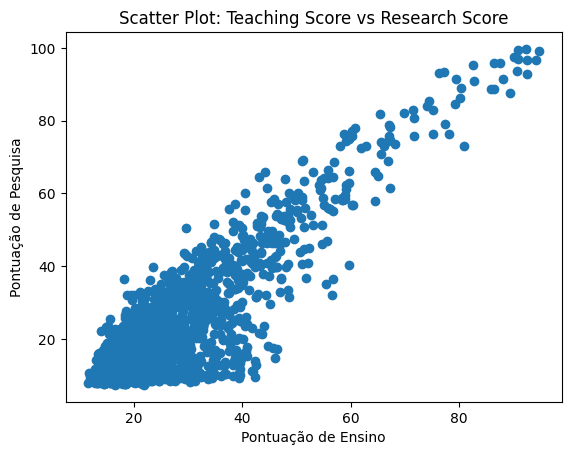

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Gráfico de Dispersão
plt.scatter(df_removed['Teaching Score'], df_removed['Research Score'])
plt.xlabel('Pontuação de Ensino')
plt.ylabel('Pontuação de Pesquisa')
plt.title('Scatter Plot: Teaching Score vs Research Score')
plt.show()

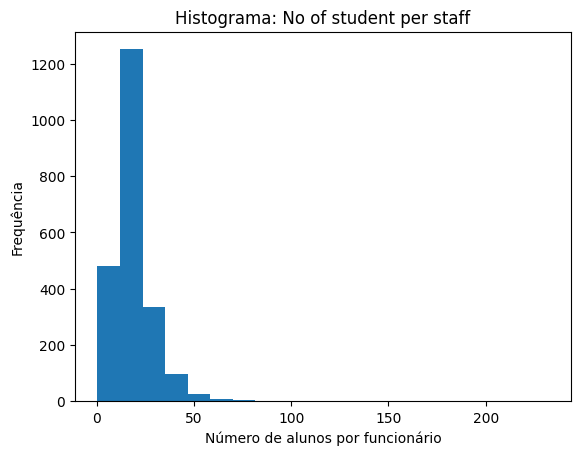

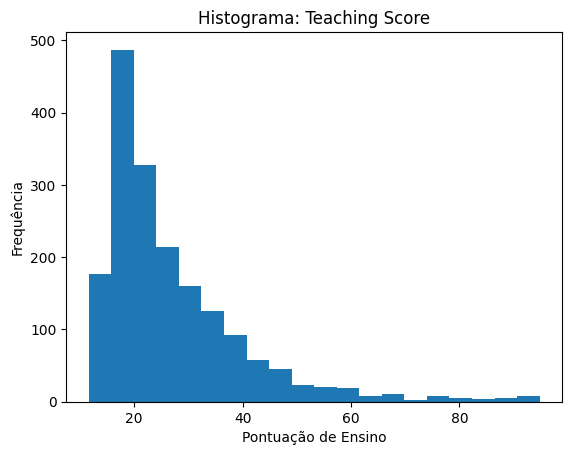

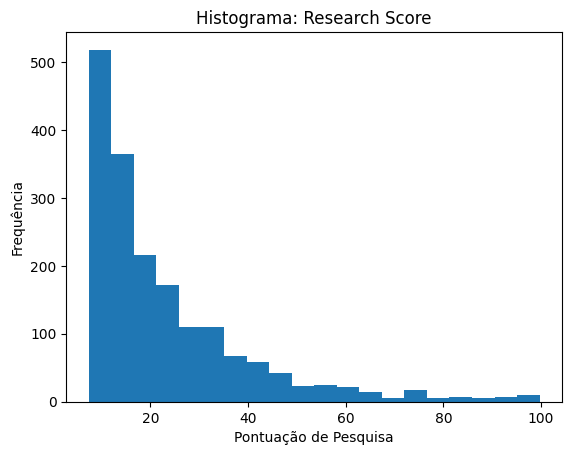

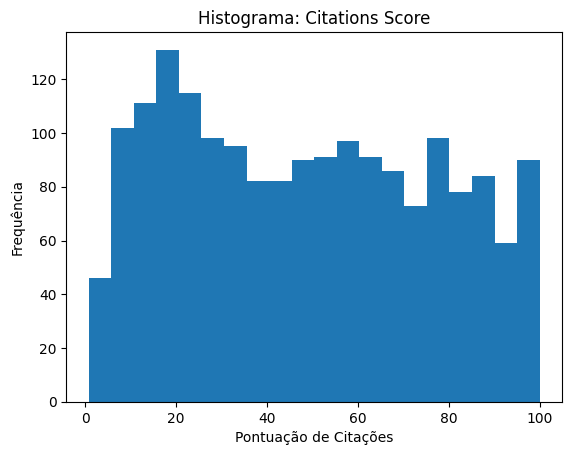

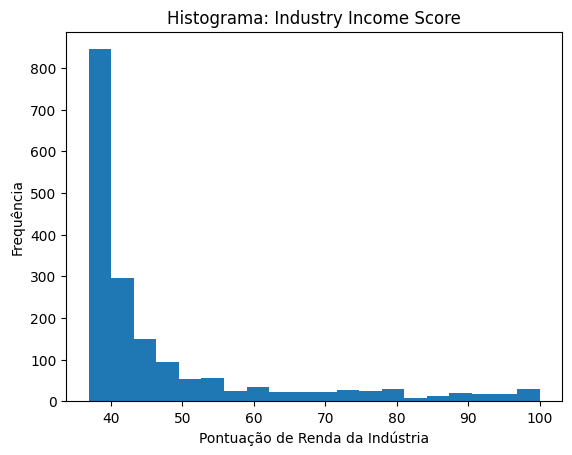

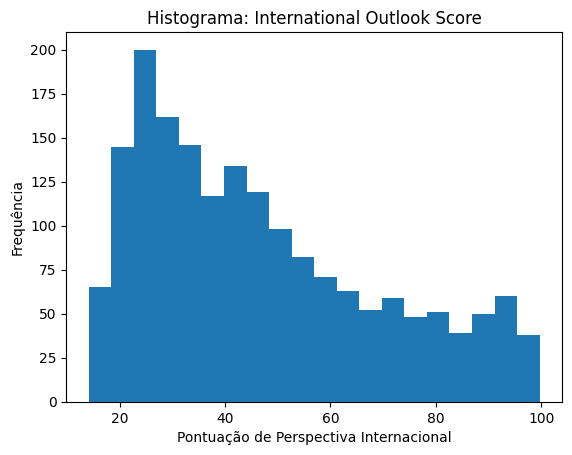

In [ ]:
# Histograma
plt.hist(df_removed['No of student per staff'], bins=20) #intervalo de 20
plt.xlabel('Número de alunos por funcionário')
plt.ylabel('Frequência')
plt.title('Histograma: No of student per staff')
plt.show()

plt.hist(df_removed['Teaching Score'], bins=20) #intervalo de 20
plt.xlabel('Pontuação de Ensino')
plt.ylabel('Frequência')
plt.title('Histograma: Teaching Score')
plt.show()

plt.hist(df_removed['Research Score'], bins=20) #intervalo de 20
plt.xlabel('Pontuação de Pesquisa')
plt.ylabel('Frequência')
plt.title('Histograma: Research Score')
plt.show()


plt.hist(df_removed['Citations Score'], bins=20) #intervalo de 20
plt.xlabel('Pontuação de Citações')
plt.ylabel('Frequência')
plt.title('Histograma: Citations Score')
plt.show()


plt.hist(df_removed['Industry Income Score'], bins=20) #intervalo de 20
plt.xlabel('Pontuação de Renda da Indústria')
plt.ylabel('Frequência')
plt.title('Histograma: Industry Income Score')
plt.show()


plt.hist(df_removed['International Outlook Score'], bins=20) #intervalo de 20
plt.xlabel('Pontuação de Perspectiva Internacional')
plt.ylabel('Frequência')
plt.title('Histograma: International Outlook Score')
plt.show()



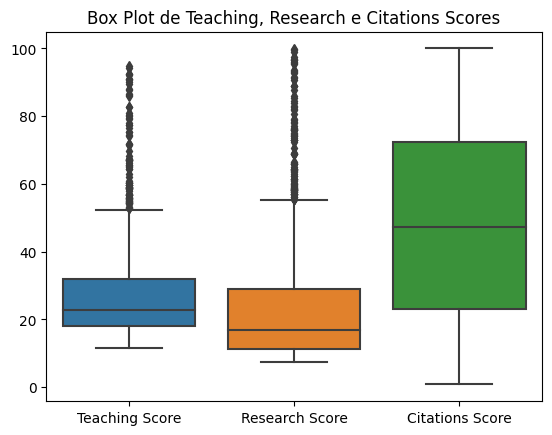

In [ ]:
# Box Plot
sns.boxplot(data=df_removed[['Teaching Score', 'Research Score', 'Citations Score']])
plt.title('Box Plot de Teaching, Research e Citations Scores')
plt.show()

#Nota-se um grande nuemro de outliers no teaching score e no research score

<ipython-input-11-0ee11c2bfb75>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_removed.corr()


,No of student per staff,Teaching Score,Research Score,Citations Score,Industry Income Score,International Outlook Score
No of student per staff,1.000000,-0.130569,0.006686,-0.005684,-0.002588,0.029470
Teaching Score,-0.130569,1.000000,0.882181,0.451169,0.492579,0.385006
Research Score,0.006686,0.882181,1.000000,0.514013,0.583051,0.537993
Citations Score,-0.005684,0.451169,0.514013,1.000000,0.182949,0.536379
Industry Income Score,-0.002588,0.492579,0.583051,0.182949,1.000000,0.218060
International Outlook Score,0.029470,0.385006,0.537993,0.536379,0.218060,1.000000


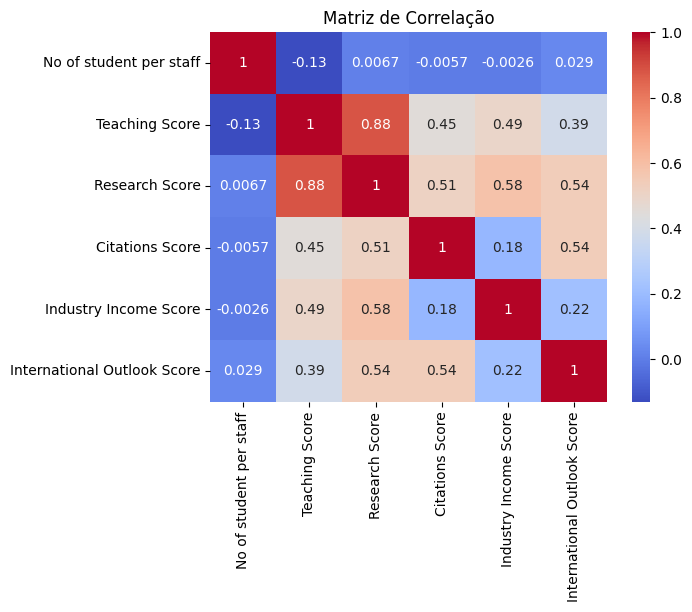

In [ ]:
# Matriz de Correlação (Heatmap)
correlation_matrix = df_removed.corr()

display(correlation_matrix)

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlação')
plt.show()

#Observa-se que research score e teaching score tem uma relação muito alta entre eles, ou seja quando uma variável
#aumenta, a outra tende a aumentar também.

#Citantions score e No of students per staff tem relação quase zero entre si, assim como research score e No of students per staff
# e industry income score e No of students per staff

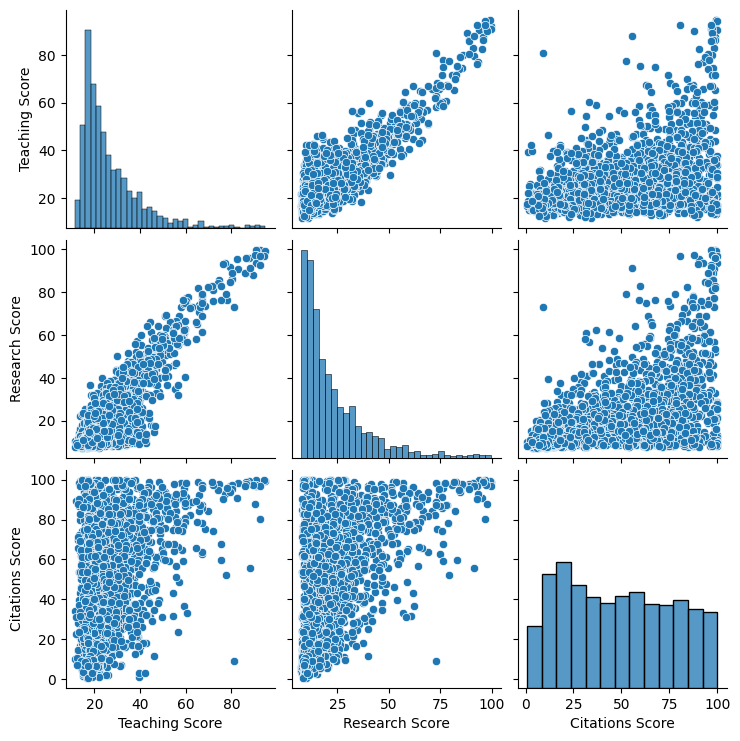

In [ ]:
# Gráfico de Caixas Emparelhadas (Pairplot)
sns.pairplot(df_removed, vars=['Teaching Score', 'Research Score', 'Citations Score'])
plt.show()

#São gráficos de dispersão para todos os pares possíveis de variáveis numéricas em um conjunto de dados e também exibe histogramas nas
#diagonais para mostrar a distribuição de cada variável individual.

#Como observado anteriormente research score e teaching score mantem uma relação muito forte e linear entre si
#Os dados não apresentam outliers visiveis
#

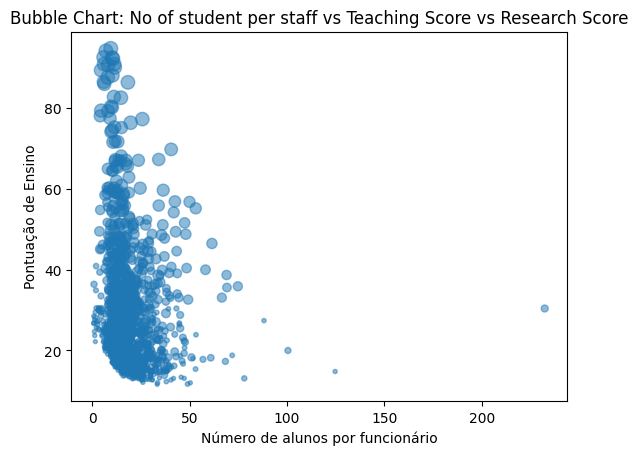

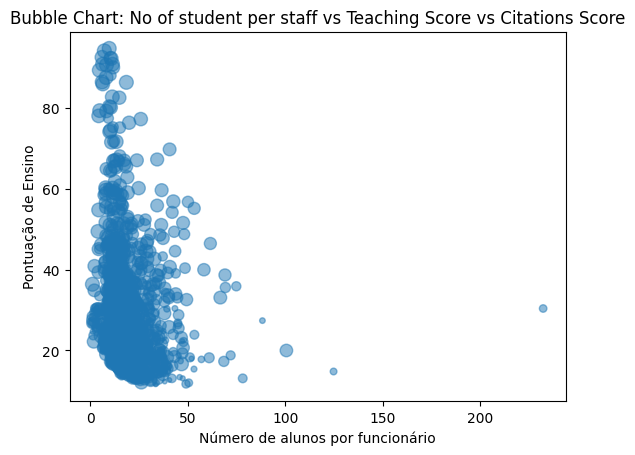

In [ ]:
# Gráfico de Bolhas (Bubble Chart)
plt.scatter(df_removed['No of student per staff'], df_removed['Teaching Score'], s=df_removed['Research Score'], alpha=0.5)
plt.xlabel('Número de alunos por funcionário')
plt.ylabel('Pontuação de Ensino')
plt.title('Bubble Chart: No of student per staff vs Teaching Score vs Research Score')
plt.show()

#É possivel analisar um outlier no dado mas a grande maioria se ve de maneira concentrada

plt.scatter(df_removed['No of student per staff'], df_removed['Teaching Score'], s=df_removed['Citations Score'], alpha=0.5)
plt.xlabel('Número de alunos por funcionário')
plt.ylabel('Pontuação de Ensino')
plt.title('Bubble Chart: No of student per staff vs Teaching Score vs Citations Score')
plt.show()


[0 2 1 'NaN']


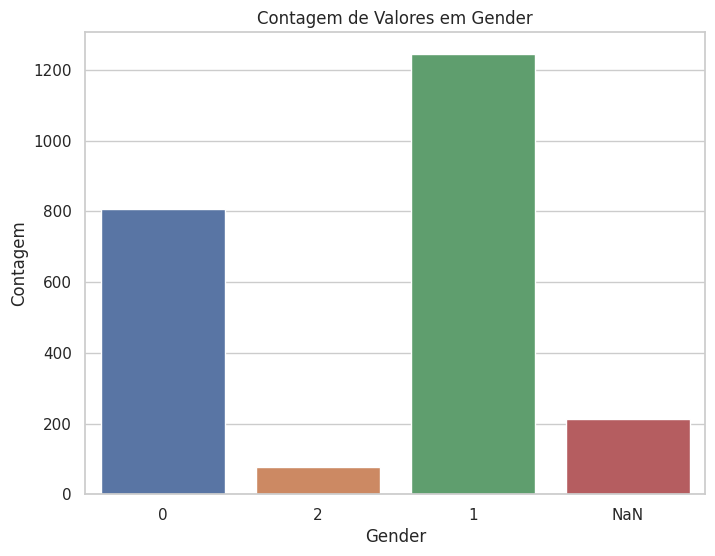

,University Rank,No of student,No of student per staff,International Student,OverAll Score,Teaching Score,Research Score,Citations Score,Industry Income Score,International Outlook Score,Gender
0,1,"20,965",10.6,42%,96.4,92.3,99.7,99.0,74.9,96.2,0
1,2,"21,887",9.6,25%,95.2,94.8,99.0,99.3,49.5,80.5,2
2,3,"20,185",11.3,39%,94.8,90.9,99.5,97.0,54.2,95.8,0
3,3,"16,164",7.1,24%,94.8,94.2,96.7,99.8,65.0,79.8,0
4,5,"11,415",8.2,33%,94.2,90.7,93.6,99.8,90.9,89.3,0
...,...,...,...,...,...,...,...,...,...,...,...
2336,-,NaN,NaN,NaN,34.0–39.2,24.1,15.5,61.5,37.9,76.8,1
2337,-,NaN,NaN,NaN,34.0–39.2,35.1,29.4,34.5,44.2,88.7,1
2338,-,NaN,NaN,NaN,34.0–39.2,18.2,14.3,68.8,37.3,72.0,1
2339,-,NaN,NaN,NaN,34.0–39.2,26.4,26.7,52.8,52.1,47.6,1


In [ ]:
#Trantando os dados de Female:Male Ratio

#Modificando o valor de string para int
def define_gender(ratio):
    if pd.isna(ratio) or ratio.lower() == 'nan':
        return 'NaN'  # Valor nulo ou inválido

    female, male = map(int, ratio.split(' : '))

    if male == 0 and female > 0:
        return 1 # Valor nulo ou inválido

    if male == 0 :
        return 'NaN' # Valor nulo ou inválido

    if male == female:
      return 2

    if female / male > 1:
        return 1  #mais mulheres
    else:
        return 0  #mais Homens


# Aplicando a função para criar a nova coluna "Gender"
df_removed['Gender'] = df_removed['Female:Male Ratio'].apply(define_gender)


#Analisando a nova coluna Gender
unique_values = df_removed['Gender'].unique()
print(unique_values)

sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))
sns.countplot(data=df_removed, x="Gender")
plt.title("Contagem de Valores em Gender")
plt.xlabel("Gender")
plt.ylabel("Contagem")

plt.show()


#Substituindo os valores nulos pela moda (1)
df_filled = df_removed.drop(columns=['Female:Male Ratio'])
df_filled['Gender'] = df_filled['Gender'].replace('NaN', 1)



display(df_filled)


In [ ]:
df_filled.replace('', pd.NA, inplace=True) #Tratando espaços vazios para null
df_filled.isnull().sum() #Contagem de quantos dados faltantes existem nos dados

University Rank                  0
No of student                  132
No of student per staff        133
International Student          132
OverAll Score                  542
Teaching Score                 542
Research Score                 542
Citations Score                542
Industry Income Score          542
International Outlook Score    542
Gender                           0
dtype: int64

In [ ]:
#Tratando No of student per staff (Número de alunos por funcionário)
#No of student per staff 133 dados faltantes
#Utilizando a media pois o grafico tem um pico de frequencia muito nitido
median_value = df_filled['No of student per staff'].median()
df_filled['No of student per staff'].fillna(median_value, inplace=True)


In [ ]:
#Tratando a coluna International Student
#removendo a % dos valores e convertendo todos para float
df_filled['International Student'] = pd.to_numeric(df_filled['International Student'].str.rstrip('%'), errors='coerce').round(2)/100

#Removendo os valores vazios adicionando a media de alunos internacionais nas universidades
media_value = df_filled['International Student'].mean().round(2)
print('Media: '  , median_value)
df_filled['International Student'].fillna(media_value, inplace=True)

df_filled

Media:  16.6


,University Rank,No of student,No of student per staff,International Student,OverAll Score,Teaching Score,Research Score,Citations Score,Industry Income Score,International Outlook Score,Gender
0,1,"20,965",10.6,0.42,96.4,92.3,99.7,99.0,74.9,96.2,0
1,2,"21,887",9.6,0.25,95.2,94.8,99.0,99.3,49.5,80.5,2
2,3,"20,185",11.3,0.39,94.8,90.9,99.5,97.0,54.2,95.8,0
3,3,"16,164",7.1,0.24,94.8,94.2,96.7,99.8,65.0,79.8,0
4,5,"11,415",8.2,0.33,94.2,90.7,93.6,99.8,90.9,89.3,0
...,...,...,...,...,...,...,...,...,...,...,...
2336,-,NaN,16.6,0.10,34.0–39.2,24.1,15.5,61.5,37.9,76.8,1
2337,-,NaN,16.6,0.10,34.0–39.2,35.1,29.4,34.5,44.2,88.7,1
2338,-,NaN,16.6,0.10,34.0–39.2,18.2,14.3,68.8,37.3,72.0,1
2339,-,NaN,16.6,0.10,34.0–39.2,26.4,26.7,52.8,52.1,47.6,1


In [ ]:
#Tratando a coluna Research Score e Teaching Score
#Na Matriz de Correlação (Heatmap), observa-se que research score e teaching score tem uma relação muito alta entre eles (0.88), ou seja quando uma variável
#aumenta, a outra tende a aumentar também.

#Sendo assim, a opção foi remover uma delas do dataset, e a Teaching Score foi a escolhida para ser removida
df_remove_correlacao= df_filled.drop(columns=['Teaching Score'])

media_value = df_remove_correlacao['Research Score'].mean()
df_remove_correlacao['Research Score'].fillna(media_value, inplace=True)



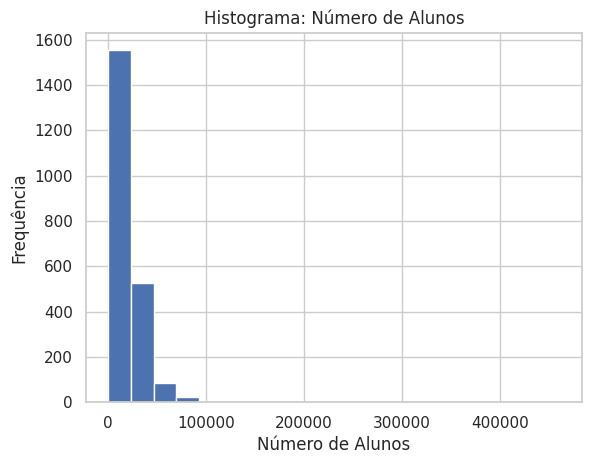

14292.0


,University Rank,No of student,No of student per staff,International Student,OverAll Score,Research Score,Citations Score,Industry Income Score,International Outlook Score,Gender
0,1,20965.0,10.6,0.42,96.4,99.7,99.0,74.9,96.2,0
1,2,21887.0,9.6,0.25,95.2,99.0,99.3,49.5,80.5,2
2,3,20185.0,11.3,0.39,94.8,99.5,97.0,54.2,95.8,0
3,3,16164.0,7.1,0.24,94.8,96.7,99.8,65.0,79.8,0
4,5,11415.0,8.2,0.33,94.2,93.6,99.8,90.9,89.3,0
...,...,...,...,...,...,...,...,...,...,...
2336,-,14292.0,16.6,0.10,34.0–39.2,15.5,61.5,37.9,76.8,1
2337,-,14292.0,16.6,0.10,34.0–39.2,29.4,34.5,44.2,88.7,1
2338,-,14292.0,16.6,0.10,34.0–39.2,14.3,68.8,37.3,72.0,1
2339,-,14292.0,16.6,0.10,34.0–39.2,26.7,52.8,52.1,47.6,1


In [ ]:
#Tratando a coluna No of student
#remover as virgulas dos dados
df_remove_correlacao['No of student'] = pd.to_numeric(df_remove_correlacao['No of student'].str.replace(',', ''), errors='coerce')


plt.hist(df_remove_correlacao['No of student'], bins=20)
plt.xlabel('Número de Alunos')
plt.ylabel('Frequência')
plt.title('Histograma: Número de Alunos')
plt.show()

#tratando valores nulos com a mediana já que existe um pico muito definido
media_value = df_remove_correlacao['No of student'].median()
print(media_value)
df_remove_correlacao['No of student'].fillna(media_value, inplace=True)


df_remove_correlacao

In [ ]:
df_remove_correlacao.isnull().sum()

University Rank                  0
No of student                    0
No of student per staff          0
International Student            0
OverAll Score                  542
Research Score                   0
Citations Score                542
Industry Income Score          542
International Outlook Score    542
Gender                           0
dtype: int64

In [ ]:
#Tratando as colunas Research Score, Citations Score,	Industry Income Score e International Outlook Score
#Todos os dados não apresentam picos centrais de dados logo usaremos a media para dados faltantes
media_value = df_remove_correlacao['Research Score'].mean()
print(media_value)
df_remove_correlacao['Research Score'].fillna(media_value, inplace=True)

media_value = df_remove_correlacao['Citations Score'].mean()
print(media_value)
df_remove_correlacao['Citations Score'].fillna(media_value, inplace=True)

media_value = df_remove_correlacao['Industry Income Score'].mean()
print(media_value)
df_remove_correlacao['Industry Income Score'].fillna(media_value, inplace=True)

media_value = df_remove_correlacao['International Outlook Score'].mean()
print(media_value)
df_remove_correlacao['International Outlook Score'].fillna(media_value, inplace=True)



23.01689827682046
48.4958866036687
47.10455808782657
46.88037798777098


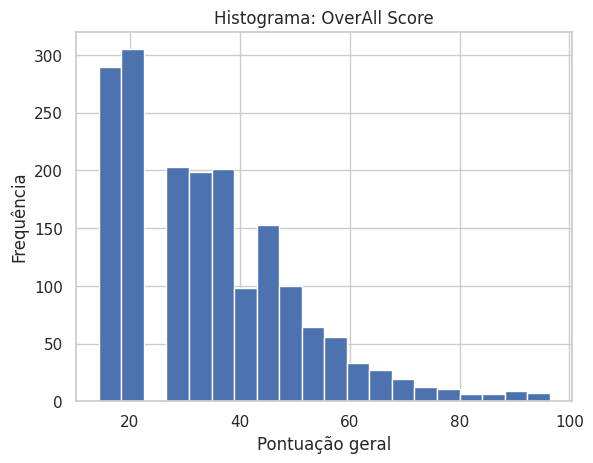

34.16586992773763


In [ ]:
#Tratando a coluna OverAll Score
#algumas entradas na coluna contem um intervalo "34.0–39.2"
#escolhemos substituir as entradas com intervalo pelo valor médio do intervalo
def transform_score(score):
    if pd.isna(score) or score.lower() == 'nan':
        return 'NaN'  # Valor nulo ou inválido
    if '–' in score:
        lower, upper = map(float, score.split('–'))
        return (lower + upper) / 2
    return float(score)

df_remove_correlacao['OverAll Score'] = pd.to_numeric(df_remove_correlacao['OverAll Score'].apply(transform_score), errors='coerce')



plt.hist(df_remove_correlacao['OverAll Score'], bins=20) #intervalo de 20
plt.xlabel('Pontuação geral')
plt.ylabel('Frequência')
plt.title('Histograma: OverAll Score')
plt.show()

#Tratando os valores nulos com a media
media_value = df_remove_correlacao['OverAll Score'].mean()
print(media_value)
df_remove_correlacao['OverAll Score'].fillna(media_value, inplace=True)

In [ ]:
display(df_remove_correlacao.isnull().sum())
display(df_remove_correlacao)

University Rank                0
No of student                  0
No of student per staff        0
International Student          0
OverAll Score                  0
Research Score                 0
Citations Score                0
Industry Income Score          0
International Outlook Score    0
Gender                         0
dtype: int64

,University Rank,No of student,No of student per staff,International Student,OverAll Score,Research Score,Citations Score,Industry Income Score,International Outlook Score,Gender
0,1,20965.0,10.6,0.42,96.4,99.7,99.0,74.9,96.2,0
1,2,21887.0,9.6,0.25,95.2,99.0,99.3,49.5,80.5,2
2,3,20185.0,11.3,0.39,94.8,99.5,97.0,54.2,95.8,0
3,3,16164.0,7.1,0.24,94.8,96.7,99.8,65.0,79.8,0
4,5,11415.0,8.2,0.33,94.2,93.6,99.8,90.9,89.3,0
...,...,...,...,...,...,...,...,...,...,...
2336,-,14292.0,16.6,0.10,36.6,15.5,61.5,37.9,76.8,1
2337,-,14292.0,16.6,0.10,36.6,29.4,34.5,44.2,88.7,1
2338,-,14292.0,16.6,0.10,36.6,14.3,68.8,37.3,72.0,1
2339,-,14292.0,16.6,0.10,36.6,26.7,52.8,52.1,47.6,1


In [ ]:
#Dividindo Gender em 3 colunas novas para analise dos dados como female, male e equal
df_clean = df_remove_correlacao
df_clean['F'] = 0
df_clean['M'] = 0
df_clean['Equal'] = 0

def categorize_gender(row):
    if row['Gender'] == 0: #Mais homens
        row['F'] = 0
        row['M'] = 1
        row['Equal'] = 0
    elif row['Gender'] == 1: #Mais mulheres
        row['F'] = 1
        row['M'] = 0
        row['Equal'] = 0
    elif row['Gender'] == 2: #Mesmo genero
        row['F'] = 0
        row['M'] = 0
        row['Equal'] = 1
    return row

df_clean = df_clean.apply(categorize_gender, axis=1)

df_clean = df_clean.drop(columns=['Gender'])

display(df_clean)


,University Rank,No of student,No of student per staff,International Student,OverAll Score,Research Score,Citations Score,Industry Income Score,International Outlook Score,F,M,Equal
0,1,20965.0,10.6,0.42,96.4,99.7,99.0,74.9,96.2,0,1,0
1,2,21887.0,9.6,0.25,95.2,99.0,99.3,49.5,80.5,0,0,1
2,3,20185.0,11.3,0.39,94.8,99.5,97.0,54.2,95.8,0,1,0
3,3,16164.0,7.1,0.24,94.8,96.7,99.8,65.0,79.8,0,1,0
4,5,11415.0,8.2,0.33,94.2,93.6,99.8,90.9,89.3,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...
2336,-,14292.0,16.6,0.10,36.6,15.5,61.5,37.9,76.8,1,0,0
2337,-,14292.0,16.6,0.10,36.6,29.4,34.5,44.2,88.7,1,0,0
2338,-,14292.0,16.6,0.10,36.6,14.3,68.8,37.3,72.0,1,0,0
2339,-,14292.0,16.6,0.10,36.6,26.7,52.8,52.1,47.6,1,0,0


**3.Análise Exploratória de Dados (EDA): Realize uma análise exploratória dos dados para extrair insights e entender a distribuição das classes.**



In [ ]:
df_clean.describe()

,No of student,No of student per staff,International Student,OverAll Score,Research Score,Citations Score,Industry Income Score,International Outlook Score,F,M,Equal
count,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000
mean,19317.136694,18.864032,0.101192,34.165870,23.016898,48.495887,47.104558,46.880378,0.622384,0.344297,0.033319
std,24501.701175,11.795498,0.130218,14.167933,14.694671,24.515213,13.230678,19.795070,0.484895,0.475240,0.179507
min,115.000000,0.400000,0.000000,14.350000,7.400000,0.800000,36.900000,14.100000,0.000000,0.000000,0.000000
25%,7246.000000,12.800000,0.010000,21.350000,12.700000,30.000000,38.400000,31.500000,0.000000,0.000000,0.000000
50%,14292.000000,16.600000,0.050000,34.165870,22.900000,48.495887,43.800000,46.880378,1.000000,0.000000,0.000000
75%,24943.000000,21.700000,0.130000,40.650000,24.200000,64.300000,47.104558,54.300000,1.000000,1.000000,0.000000
max,460632.000000,232.200000,1.000000,96.400000,99.700000,100.000000,100.000000,99.700000,1.000000,1.000000,1.000000


In [ ]:
#Analisando a coluna principal de predicao
classe = df_clean["University Rank"]
classe.describe()

count         2341
unique         162
top       Reporter
freq           512
Name: University Rank, dtype: object

In [ ]:
df_clean["University Rank"]

0       1
1       2
2       3
3       3
4       5
       ..
2336    -
2337    -
2338    -
2339    -
2340    -
Name: University Rank, Length: 2341, dtype: object

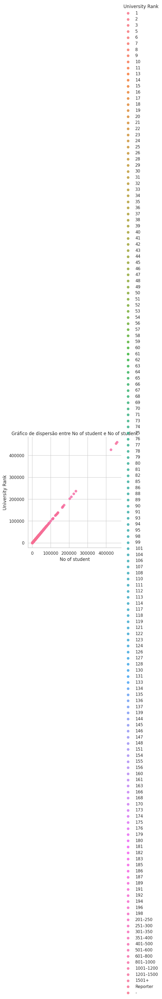

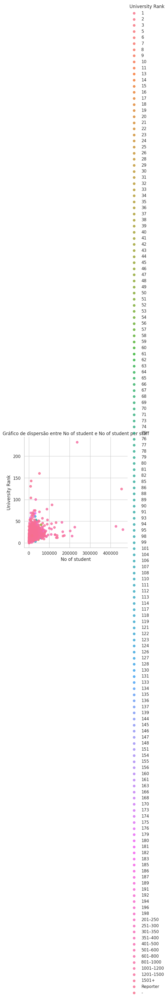

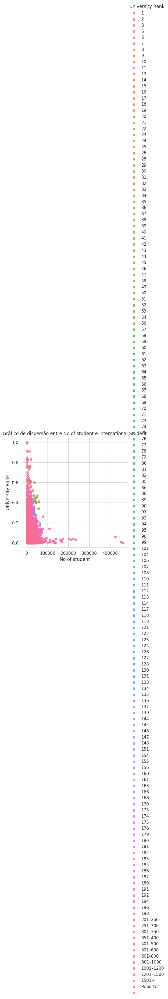

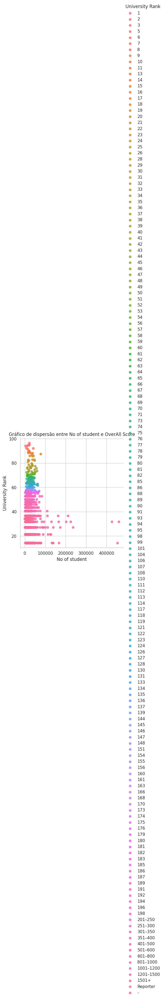

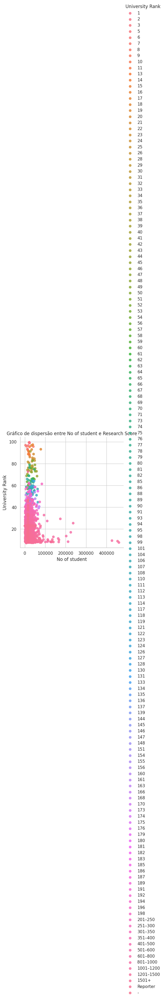

...

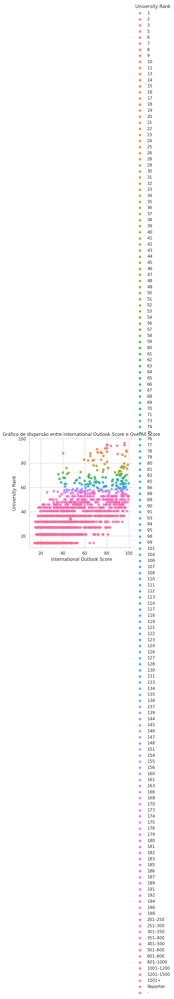

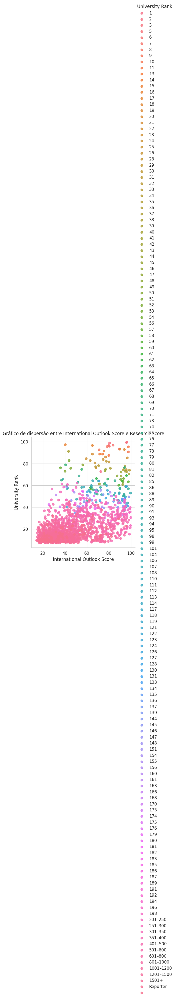

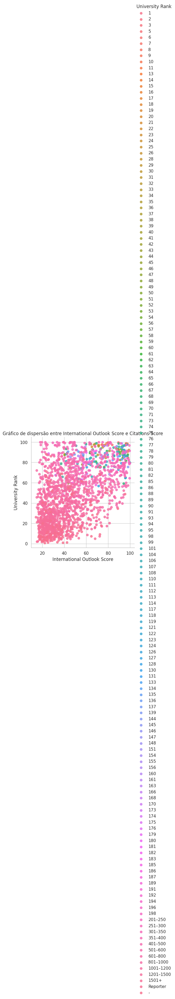

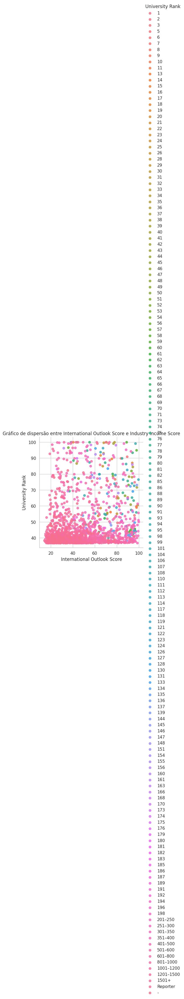

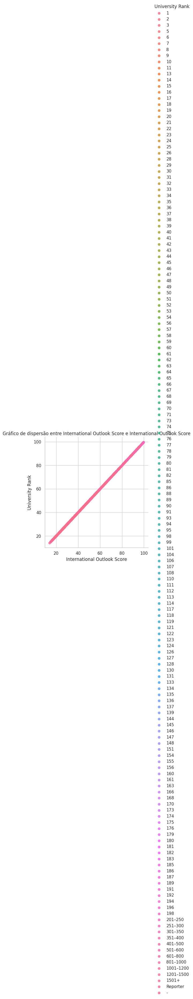

In [ ]:
# # Colunas desejadas para os gráficos scatter
colunas = ['No of student', 'No of student per staff', 'International Student', 'OverAll Score', 'Research Score', 'Citations Score', 'Industry Income Score', 'International Outlook Score']

# Criando múltiplos gráficos scatter
for coluna in colunas:
  for coluna2 in colunas:
    sns.lmplot(x=coluna, y=coluna2, data=df_clean, fit_reg=False, hue='University Rank')
    plt.title(f'Gráfico de dispersão entre {coluna} e {coluna2}')
    plt.xlabel(coluna)
    plt.ylabel('University Rank')
    plt.show()

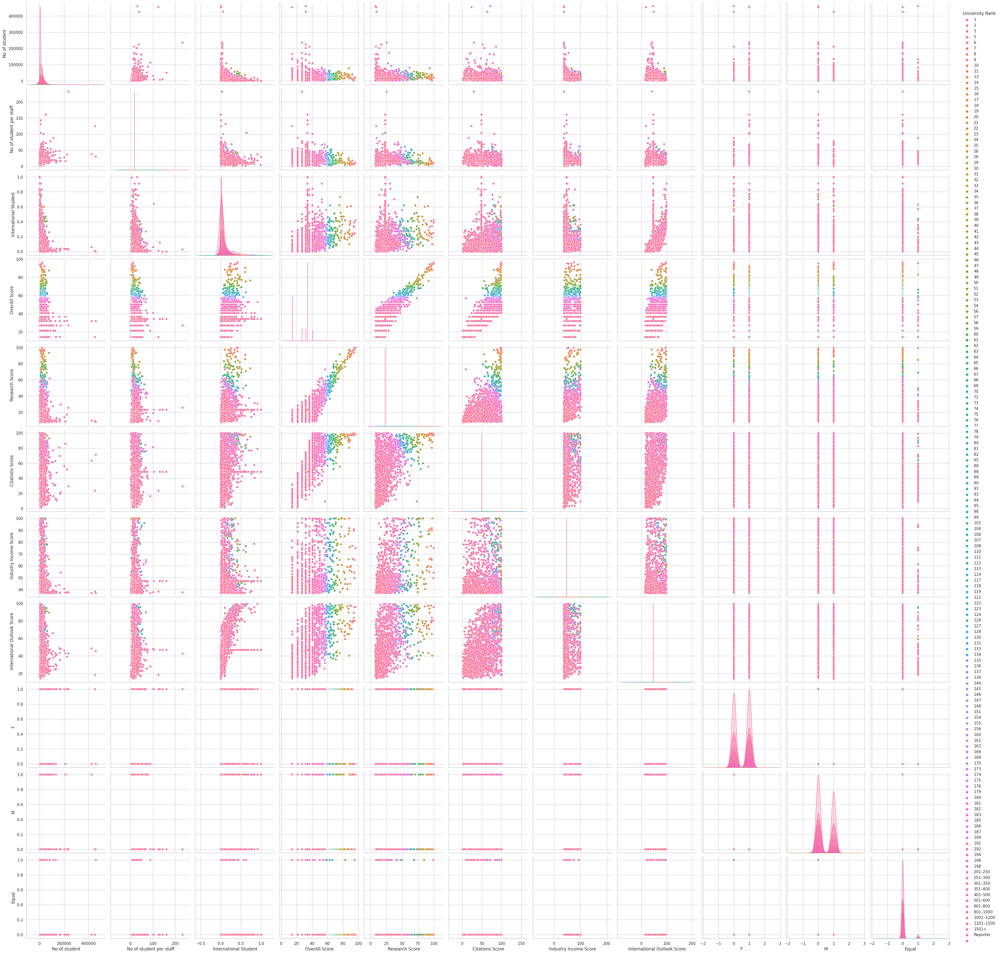

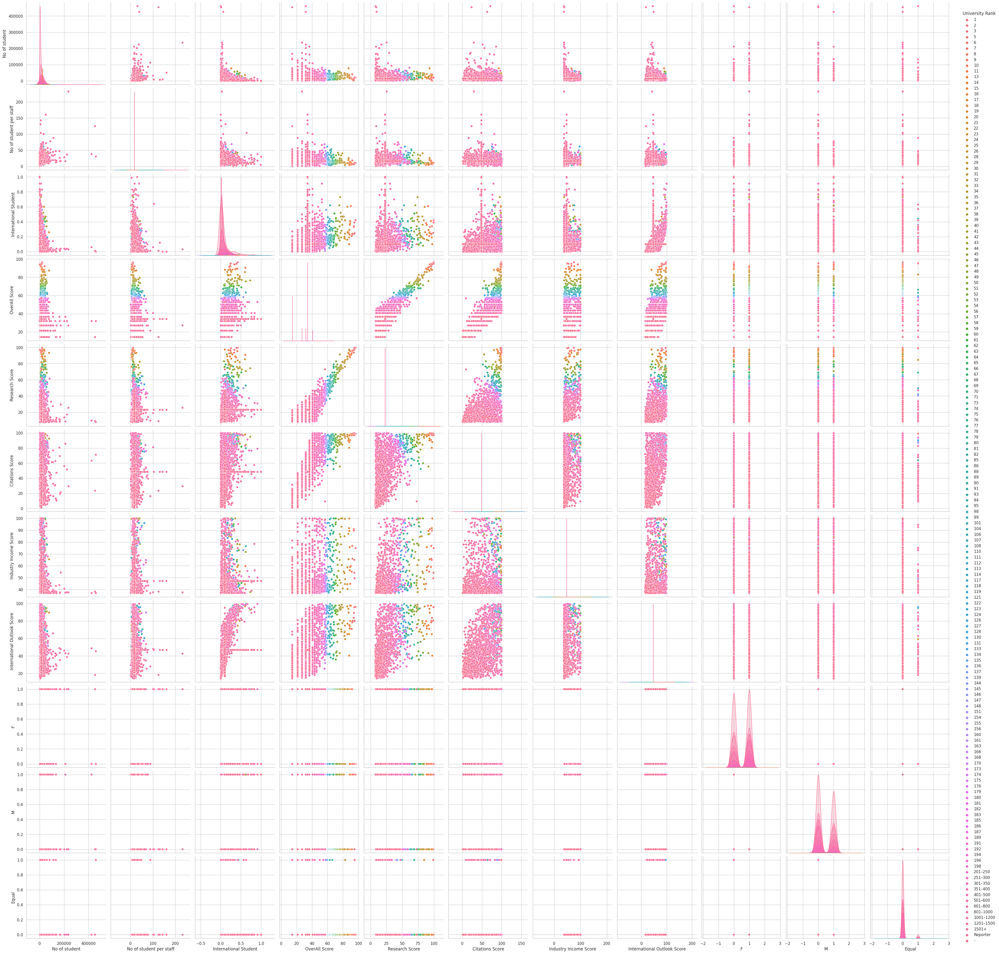

In [ ]:
# matriz de gráficos scatter (8 minutos de execucao)
sns.pairplot(df_clean, hue='University Rank', height=3.5); # size -> height

# mostra o gráfico usando a função show() da matplotlib
plt.show()

In [ ]:
#Tratamento do University Rank
#Esse campo possui dois problemas: seu tipo e a quantidade de nulos, podemos corrigir isso de forma simples
def transform_rank(rank):
    if pd.isna(rank) or rank.lower() == 'nan':
        return 'NaN'  # Valor nulo ou inválido
    if rank == '-':
        return float(0)
    if '–' in rank:
        lower, upper = map(float, rank.split('–'))
        return (lower + upper) / 2
    if 'Reporter' in rank:
        return float(-1)
    if '1501+' in rank:
        return float(1501)
    return float(rank)

df_format_rank = df_clean
df_format_rank['University Rank'] = pd.to_numeric(df_clean['University Rank'].apply(transform_rank), errors='coerce')
df_format_rank

,University Rank,No of student,No of student per staff,International Student,OverAll Score,Research Score,Citations Score,Industry Income Score,International Outlook Score,F,M,Equal
0,1.0,20965.0,10.6,0.42,96.4,99.7,99.0,74.9,96.2,0,1,0
1,2.0,21887.0,9.6,0.25,95.2,99.0,99.3,49.5,80.5,0,0,1
2,3.0,20185.0,11.3,0.39,94.8,99.5,97.0,54.2,95.8,0,1,0
3,3.0,16164.0,7.1,0.24,94.8,96.7,99.8,65.0,79.8,0,1,0
4,5.0,11415.0,8.2,0.33,94.2,93.6,99.8,90.9,89.3,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...
2336,0.0,14292.0,16.6,0.10,36.6,15.5,61.5,37.9,76.8,1,0,0
2337,0.0,14292.0,16.6,0.10,36.6,29.4,34.5,44.2,88.7,1,0,0
2338,0.0,14292.0,16.6,0.10,36.6,14.3,68.8,37.3,72.0,1,0,0
2339,0.0,14292.0,16.6,0.10,36.6,26.7,52.8,52.1,47.6,1,0,0


,University Rank,No of student,No of student per staff,International Student,OverAll Score,Research Score,Citations Score,Industry Income Score,International Outlook Score,F,M,Equal
University Rank,1.000000,0.163627,-0.004539,-0.272785,-0.643290,-0.511788,-0.579655,-0.301207,-0.448408,-0.104309,0.099145,0.019281
No of student,0.163627,1.000000,0.317162,-0.080116,0.022770,0.027815,0.036340,-0.017059,-0.026687,0.064751,-0.090655,0.065099
No of student per staff,-0.004539,0.317162,1.000000,-0.045288,-0.020153,0.008838,0.001913,-0.002985,0.026104,0.005888,-0.012968,0.018428
International Student,-0.272785,-0.080116,-0.045288,1.000000,0.445885,0.403419,0.320079,0.167556,0.639990,0.095996,-0.098271,0.000860
OverAll Score,-0.643290,0.022770,-0.020153,0.445885,1.000000,0.866889,0.851606,0.442707,0.653454,0.111638,-0.105226,-0.022980
Research Score,-0.511788,0.027815,0.008838,0.403419,0.866889,1.000000,0.514013,0.583051,0.537993,0.039369,-0.036570,-0.009528
Citations Score,-0.579655,0.036340,0.001913,0.320079,0.851606,0.514013,1.000000,0.182949,0.536379,0.139763,-0.129116,-0.035705
Industry Income Score,-0.301207,-0.017059,-0.002985,0.167556,0.442707,0.583051,0.182949,1.000000,0.218060,-0.072195,0.074977,-0.003481
International Outlook Score,-0.448408,-0.026687,0.026104,0.639990,0.653454,0.537993,0.536379,0.218060,1.000000,0.167599,-0.162720,-0.021930
F,-0.104309,0.064751,0.005888,0.095996,0.111638,0.039369,0.139763,-0.072195,0.167599,1.000000,-0.930287,-0.238346


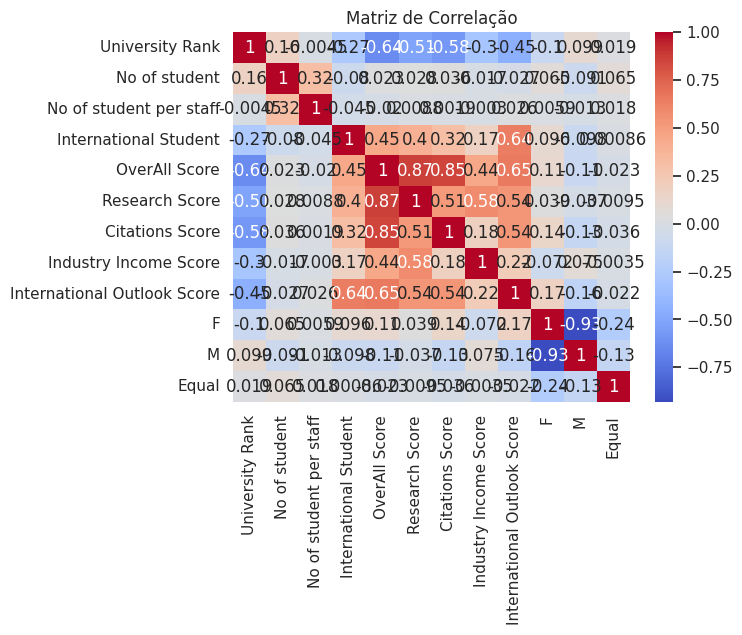

In [ ]:
# Matriz de Correlação (Heatmap)
correlation_matrix = df_format_rank.corr()

display(correlation_matrix)

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlação')
plt.show()


In [ ]:
#RRemoção das colunas com valores proxímos a 0 em comparação a coluna University Rank
df_final = df_format_rank.drop(columns=['Equal','No of student per staff'])

df_final

,University Rank,No of student,International Student,OverAll Score,Research Score,Citations Score,Industry Income Score,International Outlook Score,F,M
0,1.0,20965.0,0.42,96.4,99.7,99.0,74.9,96.2,0,1
1,2.0,21887.0,0.25,95.2,99.0,99.3,49.5,80.5,0,0
2,3.0,20185.0,0.39,94.8,99.5,97.0,54.2,95.8,0,1
3,3.0,16164.0,0.24,94.8,96.7,99.8,65.0,79.8,0,1
4,5.0,11415.0,0.33,94.2,93.6,99.8,90.9,89.3,0,1
...,...,...,...,...,...,...,...,...,...,...
2336,0.0,14292.0,0.10,36.6,15.5,61.5,37.9,76.8,1,0
2337,0.0,14292.0,0.10,36.6,29.4,34.5,44.2,88.7,1,0
2338,0.0,14292.0,0.10,36.6,14.3,68.8,37.3,72.0,1,0
2339,0.0,14292.0,0.10,36.6,26.7,52.8,52.1,47.6,1,0


# Regressão Linear



In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

# Vamos dividir os dados em recursos (X) e o alvo (y).
y_data = df_final["University Rank"]
x_data = df_final.drop(columns=["University Rank"])

# Dividir os dados em conjunto de treinamento e conjunto de teste
X_train, X_test, y_train, y_test = train_test_split(x_data, y_data, test_size=0.25, random_state=42)

#criasse um modelo de regressão linear.
model = LinearRegression()

#efetua o treino
model.fit(X_train, y_train)

# Obtém os coeficientes
coefficients = list(zip(x_data.columns, model.coef_))

# Exibe os coeficientes abaixo do outro
for coef in coefficients:
    print(f"{coef[0]}: {coef[1]}")

Coeficientes:  [('University Rank', 0.004409800014127476), ('No of student', 383.8957327435943), ('International Student', -34.376510986800184), ('OverAll Score', 10.678850865255015), ('Research Score', 1.0938318179623536), ('Citations Score', -3.580569933362611), ('Industry Income Score', -2.537105982996195), ('International Outlook Score', -26.634366773086114), ('F', 18.914038725810347)]


In [ ]:
#definição das funções que serão utilizadas para capturar as metricas e comparações posteriores
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt

def plot_loss(history):
    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.xlabel('Épocas')
    plt.ylabel('Erro')
    plt.legend()
    plt.grid(True)
    plt.show()

def validacaoCruzada():
  x_values = df_final.drop(columns=["University Rank"]).values
  y_values = df_final["University Rank"].values

  kf = KFold(n_splits = 10, random_state = 42, shuffle=True)

  scores = []

  for train_index, test_index in kf.split(x_values):

      X_train, X_test = x_values[train_index], x_values[test_index]
      y_train, y_test = y_values[train_index], y_values[test_index]

      modelo = LinearRegression()
      modelo.fit(X_train, y_train)
      y_pred = modelo.predict(X_test)
      score = modelo.score(X_test, y_test)
      scores.append(score)

  scores = np.array(scores)

  return scores;

def Normalizacao():
  x_values = df_final.drop(columns=["University Rank"])
  y_values = df_final["University Rank"]

  X_train, X_test, y_train, y_test = train_test_split(x_data, y_data, test_size=0.25, random_state=42)
  X_train = X_train.astype('float32')
  X_test = X_test.astype('float32')
  y_train = y_train.astype('float32')
  y_test = y_test.astype('float32')

  normalizer = preprocessing.Normalization()
  normalizer.adapt(X_train)

  model = keras.Sequential([
      normalizer,
      layers.Dense(1)
  ])

  model.compile(optimizer=tf.optimizers.Adam(learning_rate=0.1), loss='mean_absolute_error')
  history = model.fit(X_train, y_train,epochs=500, validation_data=(X_test, y_test), verbose=0)

  return (model, history)

Avaliações do Modelo:
R2 do modelo: 0.418982796108354

Sklern Metrics:
RMSE:  180672.32143005478
R2:  0.418982796108354

Validação Cruzada:
R2: 0.97879 (+/- 0.00)




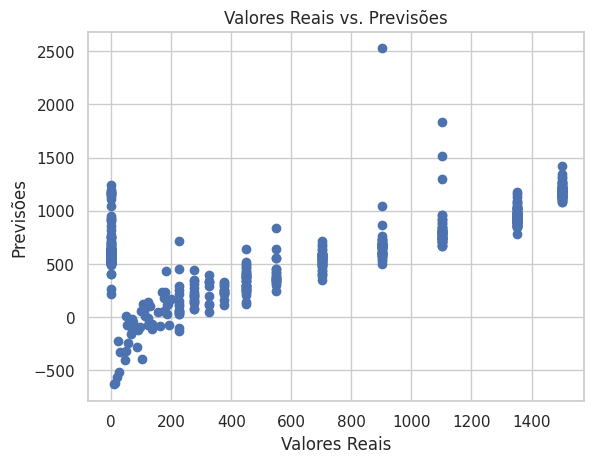


Normalização:


ValueError: ignored

In [ ]:
from sklearn import metrics
from sklearn.model_selection import KFold
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import median_absolute_error

print("Avaliações do Modelo:")
y_pred = model.predict(X_test)
print("RMSE: " , metrics.mean_squared_error(y_test, y_pred))
print("R2: " , metrics.r2_score(y_test, y_pred))
print("MAE: ", mean_absolute_error(y_test, y_pred))
print("MSE: ", mean_squared_error(y_test, y_pred))
print("MedAE: ", median_absolute_error(y_test, y_pred))

#Validação Cruzada
print("\nValidação Cruzada:")
scores = validacaoCruzada();
print("R2: %0.5f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

#Visualização dos Resultados sem Normalização
print("\n")
plt.scatter(y_test, y_pred)
plt.xlabel('Valores Reais')
plt.ylabel('Previsões')
plt.title('Valores Reais vs. Previsões')
plt.show()

#Normalização
print("\n\nAvaliações do Modelo Normalizado:")
[modelNorm, historyNorm] = Normalizacao();
y_predNomr = modelNorm.predict(X_test.astype('float32'), verbose=0)
print("RMSE: " , metrics.mean_squared_error(y_test, y_predNomr))
print("R2: " , metrics.r2_score(y_test, y_predNomr))
print("MAE: ", mean_absolute_error(y_test, y_predNomr))
print("MSE: ", mean_squared_error(y_test, y_predNomr))
print("MedAE: ", median_absolute_error(y_test, y_predNomr))

#Visualização dos Resultados com Normalização
print("\n")
plt.scatter(y_test, y_predNomr)
plt.xlabel('Valores Reais')
plt.ylabel('Previsões')
plt.title('Valores Reais vs. Previsões')
plt.show()

print("\nFunção de Custo:\n")
plot_loss(historyNorm)

#Árvore de Decisão

Análise do Modelo:
R2: 0.9984082142982013
MAPE: 0.008513826426409722
RMSE: 494.9795221843003




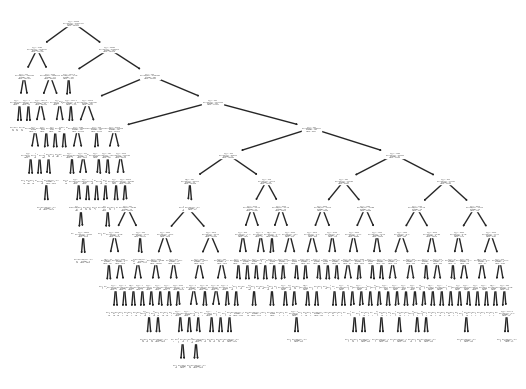

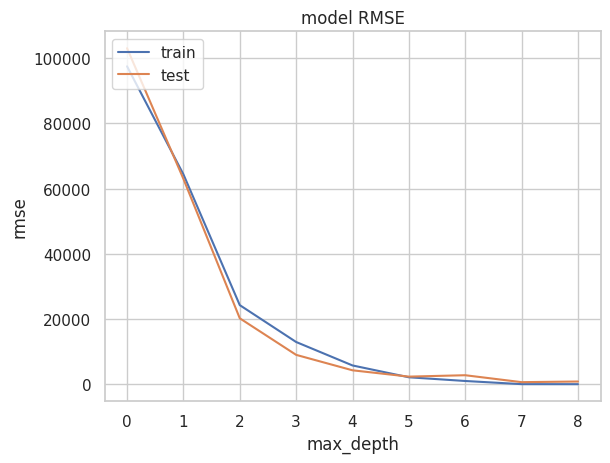

In [ ]:
import graphviz
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import export_graphviz
from sklearn.tree import plot_tree
from sklearn import metrics

# Vamos dividir os dados em recursos (X) e o alvo (y).
y_data = df_final["University Rank"]
x_data = df_final.drop(columns=["University Rank"])

# Dividir os dados em conjunto de treinamento e conjunto de teste
X_train, X_test, y_train, y_test = train_test_split(x_data, y_data, test_size=0.25, random_state=42)

#efetua o treino
tree_model = DecisionTreeRegressor()
tree_model.fit(X_train, y_train)
y_pred = tree_model.predict(X_test)

print("Análise do Modelo:")
print("R2:", tree_model.score(X_test, y_test))
print('MAPE:', metrics.mean_absolute_percentage_error(y_test, y_pred))
print('RMSE:', metrics.mean_squared_error(y_test, y_pred))

print("\n")
plot_tree(tree_model)
plt.show()

#Comparação entre Teste e Treino
history_rmse_train = []
history_rmse_test = []

for max_depth in range(1,10):
  clf = DecisionTreeRegressor(criterion='squared_error', max_depth=max_depth)
  clf = clf.fit(X_train, y_train)
  history_rmse_train.append(metrics.mean_squared_error(y_train, clf.predict(X_train)))
  history_rmse_test.append(metrics.mean_squared_error(y_test, clf.predict(X_test)))

## Avaliation
print("\n")
plt.plot(history_rmse_train)
plt.plot(history_rmse_test)
plt.title('model RMSE')
plt.ylabel('rmse')
plt.xlabel('max_depth')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

#Redes Neurais

In [ ]:
# Importações
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers.experimental import preprocessing
from sklearn.model_selection import train_test_split
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
# from tensorflow.keras.regularizers import l1, l2

In [ ]:
# Funções utilitárias para verificar as métricas de erro do modelo
def plot_loss(history):
    plt.plot(history.history['loss'][1:], label='loss')
    plt.plot(history.history['val_loss'][1:], label='val_loss')
    plt.xlabel('Épocas')
    plt.ylabel('Erro')
    plt.legend()
    plt.grid(True)
    plt.show()


def plot_acc(history):
    plt.plot(history.history['accuracy'], label='acc')
    plt.plot(history.history['val_accuracy'], label='val_acc')
    plt.xlabel('Épocas')
    plt.ylabel('Acurácia')
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_mae(history):
    plt.plot(history.history['mean_absolute_error'], label='MAE')
    plt.plot(history.history['val_mean_absolute_error'], label='Val MAE')
    plt.xlabel('Épocas')
    plt.ylabel('Mean Absolute Error')
    plt.legend()
    plt.grid(True)

def plot_mse(history):
    plt.plot(history.history['mean_squared_error'], label='MSE')
    plt.plot(history.history['val_mean_squared_error'], label='val_MSE')
    plt.xlabel('Épocas')
    plt.ylabel('Erro Quadrático Médio (MSE)')
    plt.legend()
    plt.grid(True)

In [ ]:
np.random.seed(42)
tf.random.set_seed(42)

features = df_final.columns.tolist()
features.remove('University Rank')

X = df_final[features]
y = df_final['University Rank']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=42)

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(1638, 9)
(1638,)
(703, 9)
(703,)


In [ ]:
normalizer = preprocessing.Normalization()
normalizer.adapt(X_train.values)

# Camada de entrada deve conter a quantidade de atributos que possue o dataset de train
# Camadas ocultas (intermediárias) foram encontradas através do processo empírico
# Camada de saída depende da quantidade de saídas do modelo, no caso de regressão, apenas uma saída com o valor

model = keras.Sequential([
    normalizer,
    layers.Dense(10),
    layers.Dense(100, activation='relu'),
    layers.Dense(250, activation='relu'),
    layers.Dense(70, activation='relu'),
    layers.Dense(1)
])

model.summary()

# mae no loss foi o que apresentou a melhor métrica para os erros
model.compile(optimizer='adam',
              loss='mean_absolute_error',
              metrics=['mean_absolute_error'])

# Após 200 épocas o modelo não apresenta aprendizados significativos
# Mas ele termina de aprender por volta de 600 épocas
history = model.fit(
    X_train, y_train,
    epochs=600,
    validation_split = 0.2,
    batch_size=8,
    verbose=0
    )

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizati  (None, 9)                 19        
 on)                                                             
                                                                 
 dense (Dense)               (None, 10)                100       
                                                                 
 dense_1 (Dense)             (None, 100)               1100      
                                                                 
 dense_2 (Dense)             (None, 250)               25250     
                                                                 
 dense_3 (Dense)             (None, 70)                17570     
                                                                 
 dense_4 (Dense)             (None, 1)                 71        
                                                        

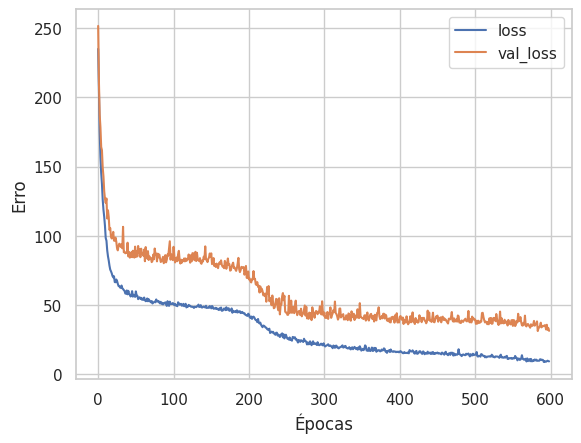

In [ ]:
plot_loss(history)

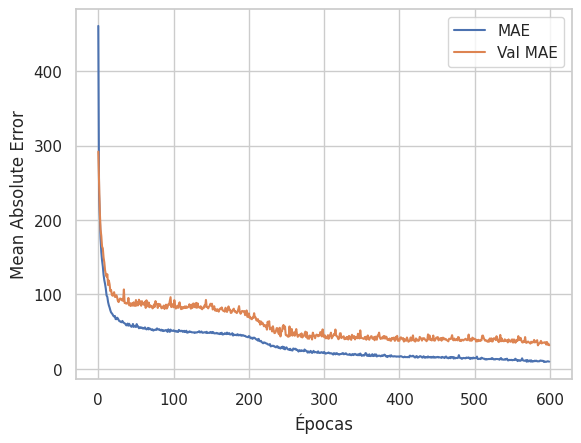

In [ ]:
plot_mae(history)

In [ ]:
y_pred = [int(value) for value in model.predict(X_test)]

## Supondo que y_pred seja um array numpy
## Arredondar os valores para inteiros
#y_pred = model.predict(X_test)
#y_pred_rounded = np.round(y_pred).astype(int)

22/22 [==============================] - 0s 3ms/step


In [ ]:
model.evaluate(X_test, y_test)

22/22 [==============================] - 0s 2ms/step - loss: 21.3693 - mean_absolute_error: 21.3693


[21.369333267211914, 21.369333267211914]

In [ ]:
print("Análise do Modelo:")
y_mean = y_test.mean()
print("Média Y Teste: ", y_mean)
y_mean_pred = np.mean(y_pred)
print("Média Y Pred: ", y_mean_pred)
mae = mean_absolute_error(y_test, y_pred)
print("MAE:", mae)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)
r2 = r2_score(y_test, y_pred)
print("R²:", r2)

Análise do Modelo:
Média Y Teste:  601.769559032717
Média Y Pred:  594.972972972973
MAE: 21.34850640113798
RMSE: 93.28749594133325
R²: 0.9714658171590428
